<a href="https://colab.research.google.com/github/mukindiru/SFCML_Assignments/blob/main/Hyperparameter_Tuning_ThurWeek7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Backgroud Information

Airbnb is an American vacation rental online marketplace company based in San
Francisco, California, United States. Airbnb offers arrangements for lodging, primarily homestays, or tourism experiences. The company does not own any of the real estate listings, nor does it host events; it acts as a broker, receiving commissions from each booking.


# Defining the Question

### a) Specifying the Data Analysis Question

As a Data Scientist working for Airbnb, you have been tasked to create a model that predicts Airbnb rental prices for the city of Amsterdam. The popularity of Airbnbs in Amsterdam has grown over the past years and you are required to build a solution that would make optimal predictions.

### b) Defining the Metric for Success

A model that accurately predicts the prices of rental prices in Amsterdam.

### c) Understanding the Context

Rental prices are key for Airbnb's busines model. It is imperative that the company be in a position to not only understand the factors impacting prices, but also be in a position to predict these prices

### d) Recording the Experimental Design

1. Collect data
2. Analyse the data
3. Model the data
4. Observations and recommendations

### e) Data Relevance

The data provided is relevant for the task

# Importing, Preparing & Understanding the Data

### Import / Install Libraries, Import the data & basic inspection / clean-up

In [1]:
#for data eda & analysis
#!pip install dataprep

In [2]:
#!pip install catboost

In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as plt

# displaying all columns
pd.set_option('display.max.columns', None)

# displaying the entire contents of a cell
pd.set_option('display.max_colwidth', None)

In [4]:
#import the data

dataseturl = 'https://raw.githubusercontent.com/mukindiru/SFCML_Assignments/main/listing_summary.csv'
dataset = pd.read_csv(dataseturl)

#dataset = dataset.replace(r"^ +| +$", r"", regex=True)

dataset.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2818,Quiet Garden View Room & Super Fast WiFi,3159,Daniel,NaN,Oostelijk Havengebied - Indische Buurt,52.36575,4.94142,Private room,59,3,278,2020-02-14,2.06,1,169
1,20168,Studio with private bathroom in the centre 1,59484,Alexander,NaN,Centrum-Oost,52.36509,4.89354,Private room,100,1,340,2020-04-09,2.76,2,106
2,25428,Lovely apt in City Centre (w.lift) near Jordaan,56142,Joan,NaN,Centrum-West,52.37297,4.88339,Entire home/apt,125,14,5,2020-02-09,0.18,1,132
3,27886,"Romantic, stylish B&B houseboat in canal district",97647,Flip,NaN,Centrum-West,52.38761,4.89188,Private room,155,2,217,2020-03-02,2.15,1,172
4,28871,Comfortable double room,124245,Edwin,NaN,Centrum-West,52.36719,4.89092,Private room,75,2,332,2020-03-16,2.82,3,210


In [5]:
#replace spaces in column names

dataset.columns = dataset.columns.str.replace(' - ', '_')
dataset.columns = dataset.columns.str.replace(' ', '')

In [6]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19362 entries, 0 to 19361
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              19362 non-null  int64  
 1   name                            19329 non-null  object 
 2   host_id                         19362 non-null  int64  
 3   host_name                       19358 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   19362 non-null  object 
 6   latitude                        19362 non-null  float64
 7   longitude                       19362 non-null  float64
 8   room_type                       19362 non-null  object 
 9   price                           19362 non-null  int64  
 10  minimum_nights                  19362 non-null  int64  
 11  number_of_reviews               19362 non-null  int64  
 12  last_review                     

A number of columns look, at the first glance to be having the wrong data type. There is however need for more analysis in ordert to understand them, and their relevance before converting them

In [7]:
#convert columns to the correct data type

#dataset.xyz = dataset.xyz.astype('category')

In [8]:
#number of records
dataset.shape

(19362, 16)

In [9]:
#drop irrelevant columns 

#dataset.drop(columns = ['xyz'], inplace = True)

#columns will be omitted later after further analysis

In [10]:
#check for duplicates
dataset.duplicated().sum()

0

dataset has no duplicate rows

In [11]:
#drop duplicates
#dataset = dataset.drop_duplicates()
#dataset.shape

DataPrep Report
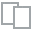
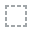
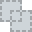
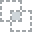
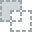
...
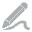
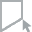
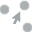
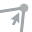
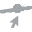

In [12]:
# dataset inpsection

from dataprep.eda import *

report = create_report(dataset)

report

**Initial observations**

1. Missing data
* Neighbourhood group feature has 100% of the values missing
* Last review and reviews per month each has 11.8% of the data missing

2. Correlation
reviews per moth and number of reviews have strong correlation

3. Several features have similar distributions

In [13]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19362 entries, 0 to 19361
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              19362 non-null  int64  
 1   name                            19329 non-null  object 
 2   host_id                         19362 non-null  int64  
 3   host_name                       19358 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   19362 non-null  object 
 6   latitude                        19362 non-null  float64
 7   longitude                       19362 non-null  float64
 8   room_type                       19362 non-null  object 
 9   price                           19362 non-null  int64  
 10  minimum_nights                  19362 non-null  int64  
 11  number_of_reviews               19362 non-null  int64  
 12  last_review                     

## Exploratory data analysis


From the above inspection, features to explore further are; 
1. Neighbourhood
2. Room type
3. minimum nights
4. number of reviews
5. availability_365
6. calculated_host_listings_count

and how they relate with the target varialbe price

In [14]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19362 entries, 0 to 19361
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              19362 non-null  int64  
 1   name                            19329 non-null  object 
 2   host_id                         19362 non-null  int64  
 3   host_name                       19358 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   19362 non-null  object 
 6   latitude                        19362 non-null  float64
 7   longitude                       19362 non-null  float64
 8   room_type                       19362 non-null  object 
 9   price                           19362 non-null  int64  
 10  minimum_nights                  19362 non-null  int64  
 11  number_of_reviews               19362 non-null  int64  
 12  last_review                     

### a. neighbourhood


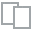
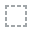
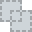
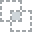
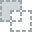
...
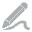
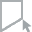
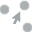
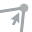
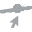

In [15]:
plot(dataset, 'neighbourhood')


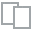
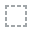
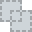
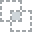
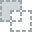
...
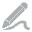
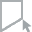
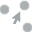
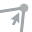
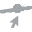

In [16]:
plot(dataset, 'neighbourhood', 'price')

### b. room_type


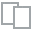
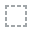
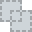
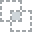
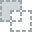
...
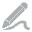
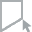
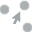
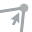
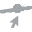

In [17]:
plot(dataset, 'room_type')


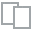
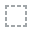
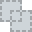
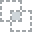
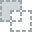
...
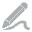
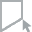
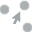
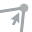
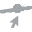

In [18]:
plot(dataset, 'room_type', 'price')

### c. minimum_nights


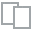
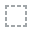
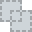
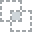
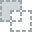
...
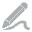
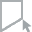
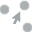
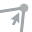
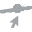

In [19]:
plot(dataset, 'minimum_nights')


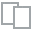
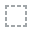
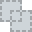
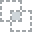
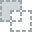
...
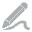
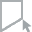
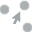
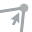
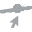

In [20]:
plot(dataset, 'minimum_nights', 'price')

### c. number_of_reviews 


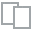
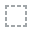
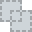
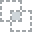
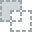
...
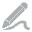
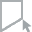
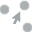
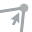
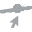

In [21]:
plot(dataset, 'number_of_reviews')


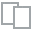
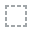
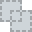
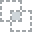
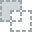
...
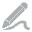
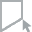
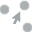
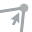
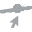

In [22]:
plot(dataset, 'number_of_reviews', 'price')

### d. reviews_per_month


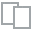
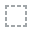
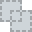
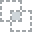
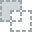
...
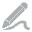
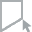
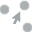
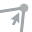
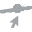

In [23]:
plot(dataset, 'reviews_per_month')



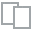
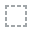
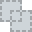
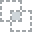
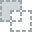
...
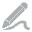
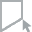
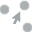
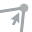
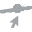

In [24]:
plot(dataset, 'reviews_per_month', 'price' )

### e. calculated_host_listings_count


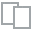
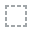
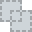
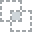
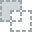
...
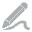
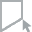
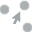
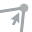
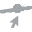

In [25]:
plot(dataset, 'calculated_host_listings_count')


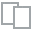
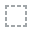
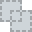
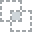
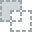
...
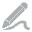
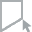
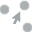
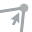
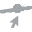

In [26]:
plot(dataset, 'calculated_host_listings_count','price')

### f. availability_365


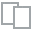
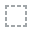
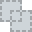
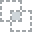
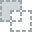
...
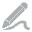
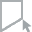
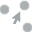
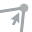
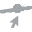

In [27]:
plot(dataset, 'availability_365')


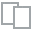
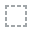
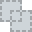
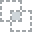
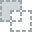
...
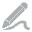
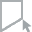
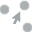
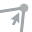
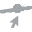

In [28]:
plot(dataset, 'availability_365','price')

### g. Multi-collinearity


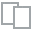
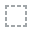
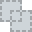
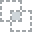
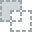
...
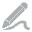
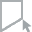
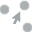
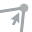
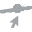

In [29]:
plot_correlation(dataset)

# Data pre-processng & Modeling

## 1. Base Model

In [30]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19362 entries, 0 to 19361
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              19362 non-null  int64  
 1   name                            19329 non-null  object 
 2   host_id                         19362 non-null  int64  
 3   host_name                       19358 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   19362 non-null  object 
 6   latitude                        19362 non-null  float64
 7   longitude                       19362 non-null  float64
 8   room_type                       19362 non-null  object 
 9   price                           19362 non-null  int64  
 10  minimum_nights                  19362 non-null  int64  
 11  number_of_reviews               19362 non-null  int64  
 12  last_review                     

In [31]:
#convert columns to the correct data type

#categorical columns
#for col in ['x','y','z']:
    #dataset[col] = dataset[col].astype('category')

#object
#dataset.x = dataset.x.astype('object')

#numeric
#dataset.y = dataset.y.astype('int64')

#target variable
#dataset.z = dataset.z.astype('object')

#for column in ['x','y','z']:
    #print("Column ", column, "is dtype:", dataset[column].dtype.name)

### Train, test split

In [32]:
# train & test data split

X = dataset[['latitude','longitude', 'room_type','minimum_nights','number_of_reviews','calculated_host_listings_count','availability_365']]
y = dataset['price']

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)

In [33]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14521 entries, 5268 to 1664
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   latitude                        14521 non-null  float64
 1   longitude                       14521 non-null  float64
 2   room_type                       14521 non-null  object 
 3   minimum_nights                  14521 non-null  int64  
 4   number_of_reviews               14521 non-null  int64  
 5   calculated_host_listings_count  14521 non-null  int64  
 6   availability_365                14521 non-null  int64  
dtypes: float64(2), int64(4), object(1)
memory usage: 907.6+ KB


### Create transformers

In [34]:
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer

#Standardize numeric data
#Encode categorical data
numeric_transformer =  Pipeline(steps=[
                                       ('imputer', SimpleImputer(strategy='median')),
                                       ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
                                          ('imputer', SimpleImputer(strategy='constant',fill_value='missing')),
                                          ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

In [35]:
#select categorical columns
categorical_cols = [#'neighbourhood', 
                    'room_type']

# Select numerical columns
numerical_cols = ['latitude',
                  'longitude',
                  'minimum_nights',
                  'number_of_reviews',
                  'calculated_host_listings_count',
                  'availability_365']


# Bundle preprocessing for numerical and categorical data
from sklearn.compose import ColumnTransformer

preprocessor = ColumnTransformer(
    transformers = [
                    ('num', numeric_transformer, numerical_cols),
                    ('cat', categorical_transformer, categorical_cols)
    ]
)

### Apply transformers on the dataset & create models

In [60]:
from sklearn.metrics import *
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVC, LinearSVC, NuSVC
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

np.random.seed(3)

regressors = [
    #LinearRegression(),
    #KNeighborsRegressor(3),
    #SVC(kernel="rbf", C=0.025, probability = True),
    #NuSVC(probability=True),
    #DecisionTreeRegressor(),
    RandomForestRegressor(),
    AdaBoostRegressor(),
    GradientBoostingRegressor(),
    XGBRegressor(),
    LGBMRegressor(),
    CatBoostRegressor(verbose=False)
    ]

for regressor in regressors:
    pipe = Pipeline(steps=[('preprocessor', preprocessor),
                               ('regressor', regressor)
                               ])
    
    trainedmodel = pipe.fit(X_train, y_train)

    #v_results = cross_val_score(regressor, X_train, y_train, cv = 3, 
                                     #scoring='r2', n_jobs = -1, verbose = 1)
    
  
    # prediction
    y_predict = trainedmodel.predict(X_test)
    mse = mean_squared_error(y_test,y_predict)
    rmse = np.sqrt(mean_squared_error(y_test, y_predict))
    r2 = r2_score(y_test,y_predict)
  

    print('\n*******************************************************************')
    print(regressor)
    print("Model score: %.3f" % pipe.score(X_test, y_test))
    print('MAE: %.3f' % mse)
    #print('Cross Validation Score: %.3f' % v_results.mean())
    print('RMSE:%.3f' % rmse)
    print('R2 Score:%.3f' % r2)


*******************************************************************
RandomForestRegressor()
Model score: 0.287
MAE: 28390.453
RMSE:168.495
R2 Score:0.287

*******************************************************************
AdaBoostRegressor()
Model score: 0.088
MAE: 36310.606
RMSE:190.553
R2 Score:0.088

*******************************************************************
GradientBoostingRegressor()
Model score: 0.218
MAE: 31129.761
RMSE:176.436
R2 Score:0.218
[06:18:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.

*******************************************************************
XGBRegressor()
Model score: 0.260
MAE: 29450.205
RMSE:171.611
R2 Score:0.260

*******************************************************************
LGBMRegressor()
Model score: 0.383
MAE: 24544.911
RMSE:156.668
R2 Score:0.383

*******************************************************************
Model score: 0.434
MAE: 22515.683
RMSE:150.052

Best performing regressor is catboost

## Hyperparamenter tuning

In [61]:
model = Pipeline(steps=[
                     ('preprocessor', preprocessor),
                     ('classifier', CatBoostRegressor(verbose=False))
])


In [62]:
from sklearn.model_selection import GridSearchCV

parameters = {'depth': [4,5,6,7,8,9, 10],
              'learning_rate' : [0.01,0.02,0.03,0.04],
              'iterations'    : [10, 20,30,40,50,60,70,80,90, 100]
              }

from sklearn.model_selection import GridSearchCV

CV = GridSearchCV(model, param_grid=parameters, n_jobs=1, scoring = 'r2')

CV.fit(X_train, y_train)

best_accurancy = CV.best_score_
best_paramenters = CV.best_params_
print('Best Accuracy:{:.2f}'.format(best_accurancy))
print('Best Paramenters:', best_paramenters)

Best Accuracy:0.27
Best Paramenters: {}
